# Image Preprocessing
_v.0.5.0_ 
* brightness standardization
* stain normalization
* image patches   --> 250 images * 35 patches = 8750 patches 
* augment patches --> $k * pi/2$

----

* [Link to CNN Model Notebook](./tech_keras_model.ipynb)

#### Imports
* image processing: cv2, PIL, StainTools, SKLearn, SKImage

In [1]:
import os
import pandas as pd
import numpy as np
import cv2
import matplotlib as plt
from PIL import Image, ImageShow
from staintools.utils.visual import read_image, show, show_colors
from staintools.utils.visual import build_stack, patch_grid
from staintools import ReinhardNormalizer, MacenkoNormalizer, VahadaneNormalizer
from staintools import standardize_brightness
from sklearn.feature_extraction.image import extract_patches_2d
import skimage.io as ski

---

#### Sample workflow: Normal Image

In [2]:
# read image as numpy ndarray

norm_img = read_image("/Volumes/sd/capstone_datasets/breasthistology/Training_data/Normal/t0.tif")

In [19]:
# norm1 = Image.open("/Volumes/sd/capstone_datasets/breasthistology/Training_data/Normal/t0.tif")|

Original: 


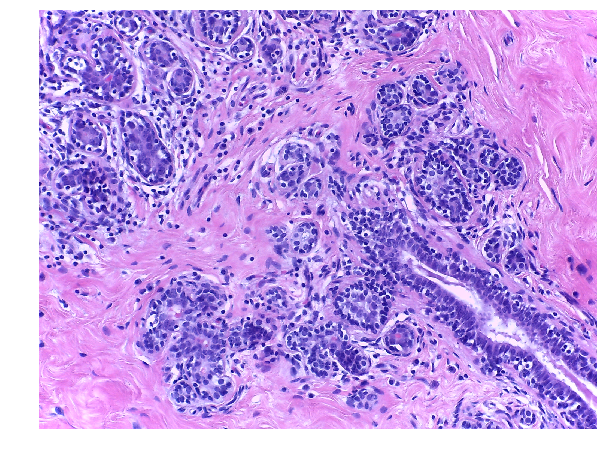

Standardized Brightness: 


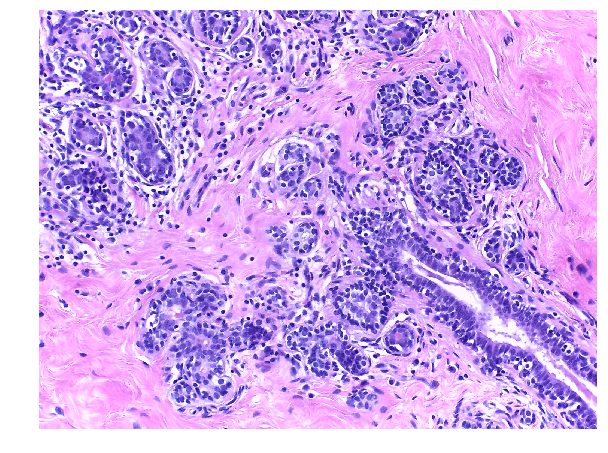

In [20]:
# Standardize Brightness
print("Original: ")
show(norm_img)
print("Standardized Brightness: ")
norm1_std = standardize_brightness(norm_img)
show(norm1_std)

In [21]:
# Vahadane H&E stain normalization

vahadane = VahadaneNormalizer()
vahadane.fit(norm1_std)
n1_vah = vahadane.transform(norm1_std)


Using brightness standardization


In [25]:
n1_patches = extract_patches_2d(n1_vah,
                                patch_size=(512,512), 
                                max_patches=35,
                                random_state=19)

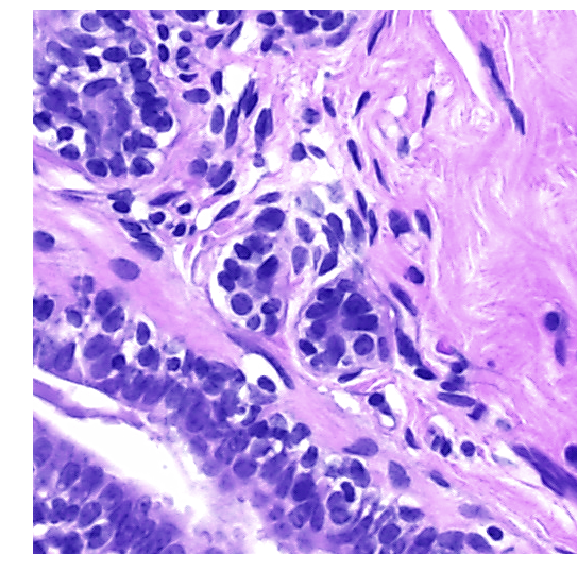

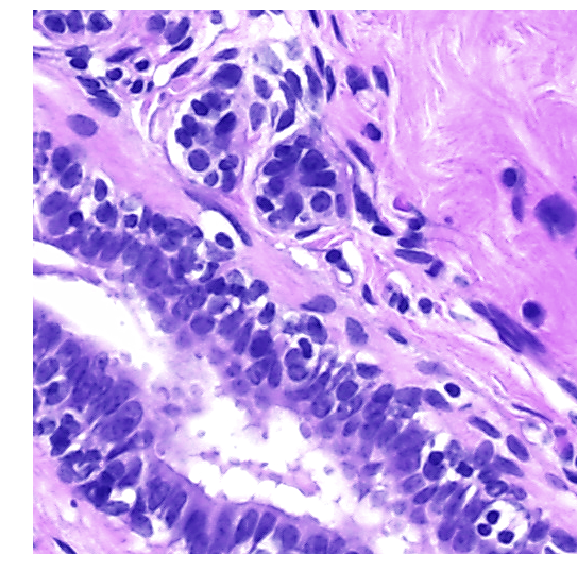

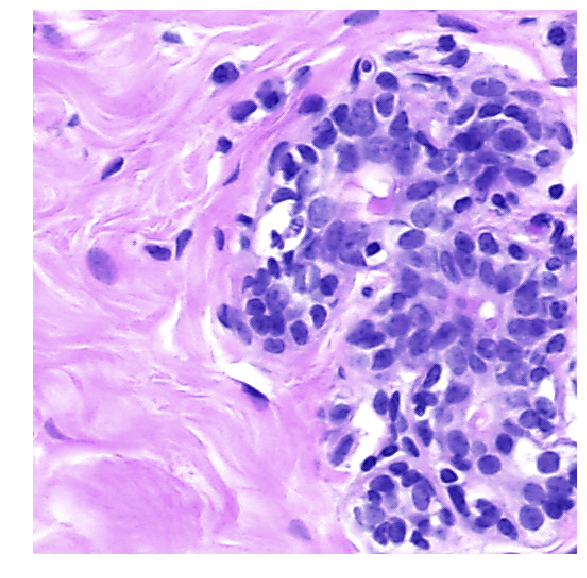

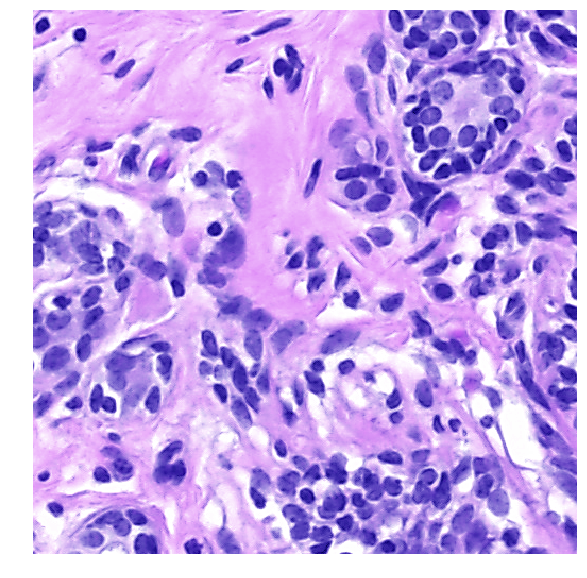

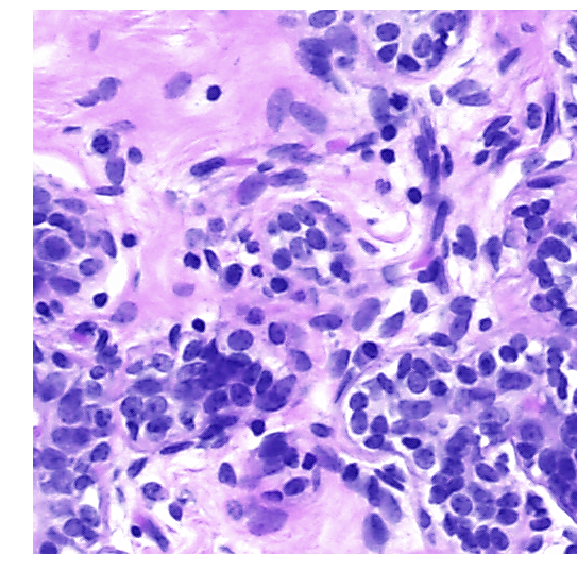

...

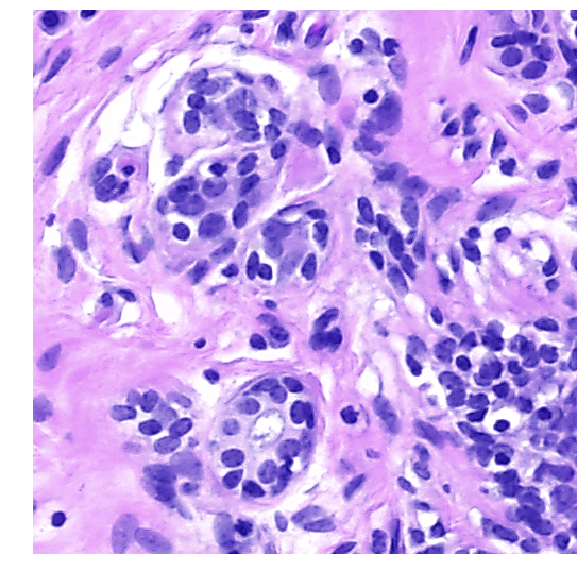

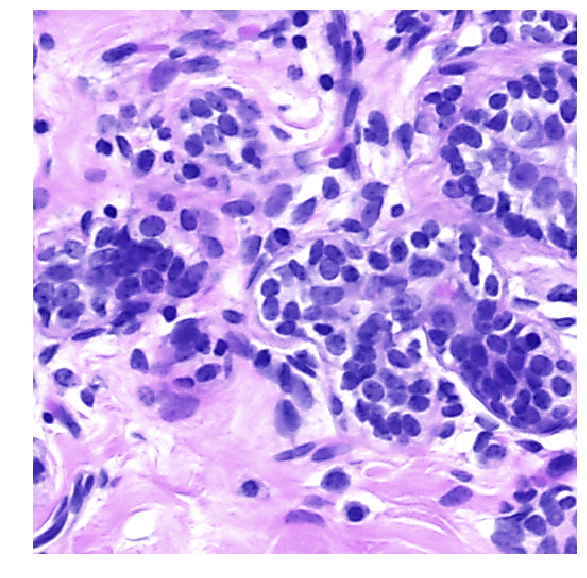

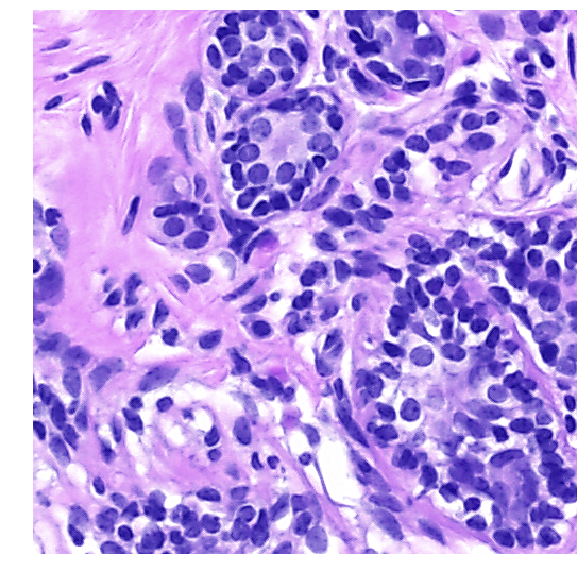

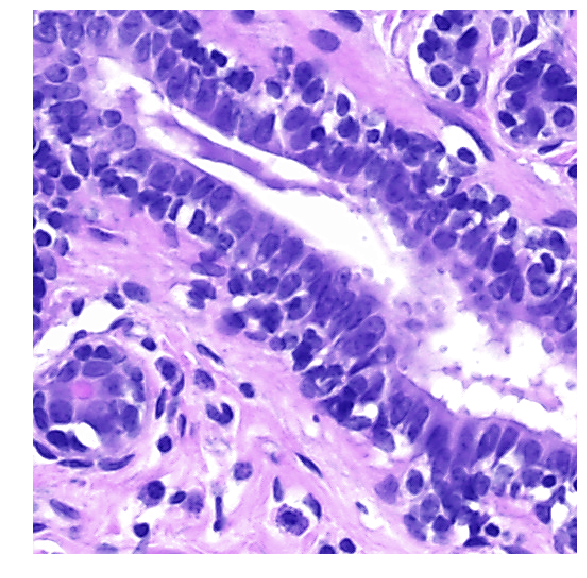

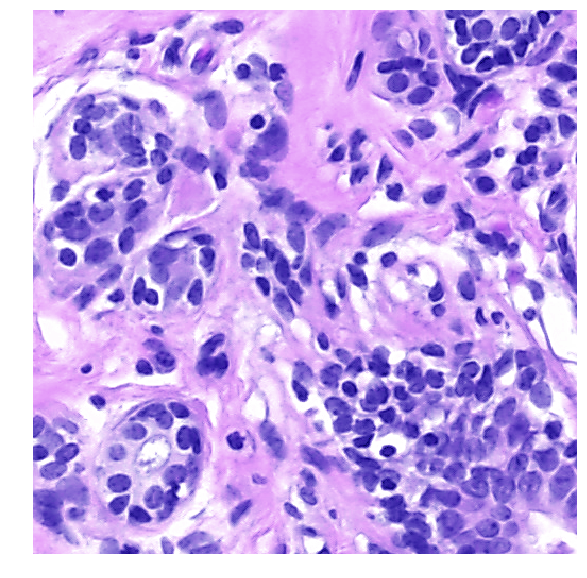

In [26]:
for patch in n1_patches:
    patch.save()

In [7]:
from typing import List

from PIL.Image import Image

n1_patch_lst: List[Image] = []
for i,x in enumerate(n1_patches):
    p = Image.fromarray(x)
    n1_patch_lst.append(p)

n1_patch_lst

[<PIL.Image.Image image mode=RGB size=512x512 at 0x11D2269B0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x11D2267B8>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x11D2260F0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x11D226668>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x11D226748>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4978>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4898>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4A20>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD49E8>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4FD0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4F60>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4EF0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4E80>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4C88>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x107CD4DA0>,
 <PIL.Image.Image image mode=RGB size=512x512 at 0x11D2

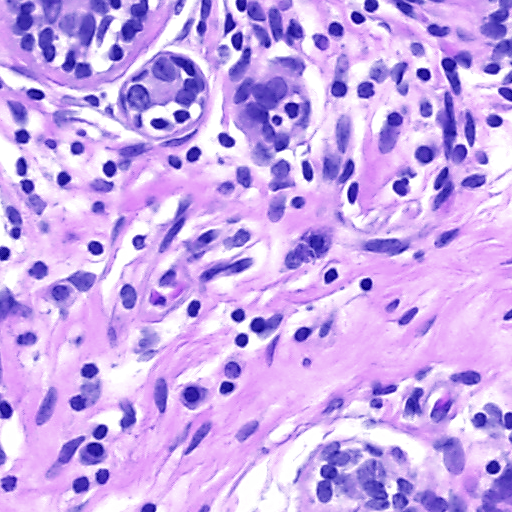

In [13]:
n1_patch_lst[1]

In [25]:
counter = 0
assert isinstance(n1_patch_lst,list)
for x in n1_patch_lst:
	x.save(f"./normald/n1_patch{counter}.png")
	counter += 1


---

#### Process the Training Set images

---

In [7]:
# 
# set paths to  variables here
norm     = "/Volumes/sd/capstone_datasets/breasthistology/Training_data/Normal/*.tif"
benign   = "/Volumes/sd/capstone_datasets/breasthistology/Training_data/Benign/*.tif"
insitu   = "/Volumes/sd/capstone_datasets/breasthistology/Training_data/In Situ/*.tif"
invasive = "/Volumes/sd/capstone_datasets/breasthistology/Training_data/Invasive/*.tif"

# create collection of images
norms     = ski.imread_collection(norm)
benigns   = ski.imread_collection(benign)
insitus   = ski.imread_collection(insitu)
invasives = ski.imread_collection(invasive)

In [8]:
# list of collection dicts, re-factor this into a more elegant solution:
# made into dicts to allow for easier identification of collection arrays

training_collection = {norm:norms, benign:benigns, insitu:insitus, invasive:invasives}

In [137]:
"n_" + os.path.split(training_collection[norm].files[0])[1].strip(".tif")

'n_0'

In [122]:
for k, v in training_collection.items():
    

[[[211 134 235]
  [211 134 237]
  [212 138 246]
  ...
  [255 184 255]
  [255 181 255]
  [255 180 255]]

 [[212 137 240]
  [209 134 238]
  [205 133 243]
  ...
  [255 182 255]
  [255 182 255]
  [255 184 255]]

 [[209 135 241]
  [205 134 241]
  [204 134 244]
  ...
  [255 182 255]
  [255 181 255]
  [255 183 255]]

 ...

 [[255 162 255]
  [255 161 255]
  [255 161 255]
  ...
  [112  84 218]
  [ 95  68 198]
  [100  70 201]]

 [[255 164 255]
  [255 162 255]
  [255 161 255]
  ...
  [100  74 208]
  [ 91  63 197]
  [ 85  57 191]]

 [[255 166 255]
  [255 163 255]
  [255 162 255]
  ...
  [ 84  58 191]
  [ 80  52 188]
  [ 84  56 192]]]
[[[246 228 255]
  [235 220 255]
  [221 210 255]
  ...
  [214 190 255]
  [206 182 255]
  [213 186 255]]

 [[222 209 255]
  [207 196 255]
  [186 180 255]
  ...
  [209 191 255]
  [213 192 255]
  [207 184 255]]

 [[147 139 244]
  [147 141 243]
  [145 141 240]
  ...
  [208 191 255]
  [202 186 255]
  [207 188 255]]

 ...

 [[222 216 255]
  [222 214 255]
  [220 212 255]
  ..

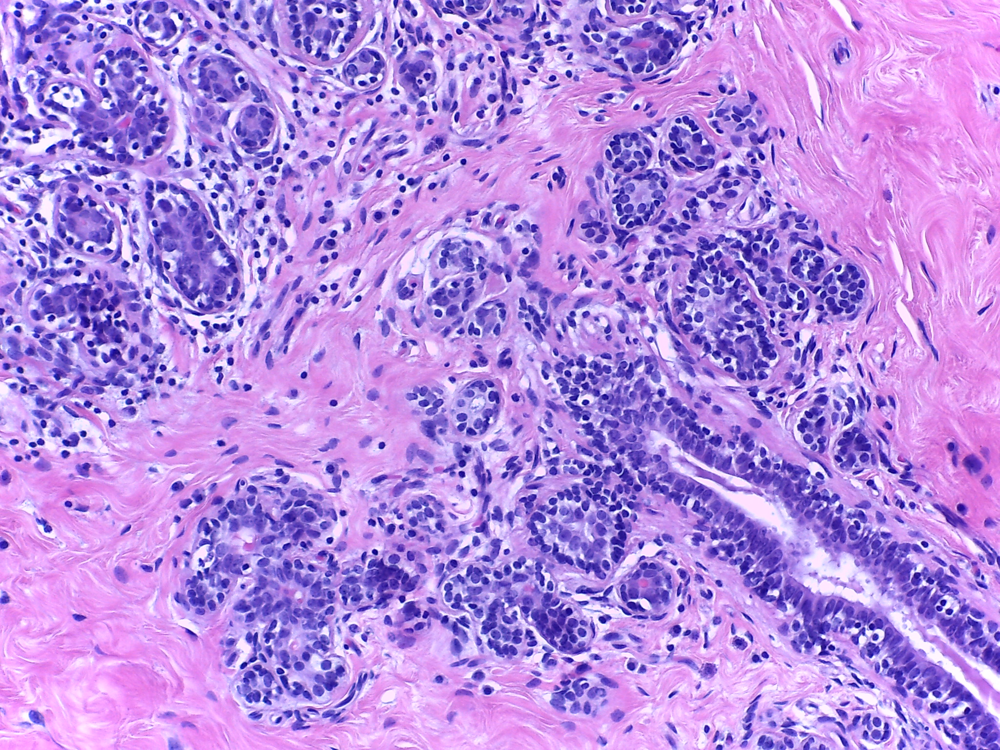

In [15]:
# PIL Image.fromarray can display the images, since they are stored as lists of numpy arrays:
Image.fromarray(training_collection[0][0])

In [147]:
## iterate through the image collections
## standardize brightness
## normalize using vahadane
## cut image into patches and save in its own folder

# initiate VahadaneNormalizer. call fit and transform with it on images
vahadane = VahadaneNormalizer()

# image collection is a dict of numpy arrays
for folder,grade in training_collection.items():
    
    # pull out the pertinent folder name from the key
    patch_dir_name = os.path.basename(folder.strip('/*.tif')) + '_patches'
    patch_dir = f"/Volumes/sd/capstone_datasets/breasthistology/Training_data/{patch_dir_name}"

    # make a directory for patches of each grading
    try:
        os.mkdir(patch_dir)
    except:
        pass
    
    # process the numpy array and save as image patch
    count = 0
    for image in grade:
        
        # use StainTools to standardize the brightness
        x = standardize_brightness(image)
        # normalize image
        vahadane.fit(x)
        x = vahadane.transform(x)
        # extract random, overlapping 512x512 patches 
        patch_array = extract_patches_2d(x,
                                    patch_size=(512,512), 
                                    max_patches=35,
                                    random_state=19)
        patches = []
        for i,patch in enumerate(patch_array):
            p = Image.fromarray(patch)
            patches.append(p)
            
        patch_count = 0
        for x in patches:
            # save patch in grade directory
            x.save(f"{patch_dir}/{count}_p{patch_count}.png")
            patch_count += 1
        
        count += 1


Using brightness standardization


---
#### Test Batch
---

In [2]:
# 
# set paths to  variables here
test     = "datasets/Test_data_patches/*.png"


# create collection of images
tests     = ski.imread_collection(test)

In [3]:
# list of collection dicts, re-factor this into a more elegant solution:
# made into dicts to allow for easier identification of collection arrays

test_collection = {test:tests}

In [4]:
"n_" + os.path.split(test_collection[test].files[0])[1].strip(".tif")

'n_0'

In [122]:
for k, v in training_collection.items():
    

[[[211 134 235]
  [211 134 237]
  [212 138 246]
  ...
  [255 184 255]
  [255 181 255]
  [255 180 255]]

 [[212 137 240]
  [209 134 238]
  [205 133 243]
  ...
  [255 182 255]
  [255 182 255]
  [255 184 255]]

 [[209 135 241]
  [205 134 241]
  [204 134 244]
  ...
  [255 182 255]
  [255 181 255]
  [255 183 255]]

 ...

 [[255 162 255]
  [255 161 255]
  [255 161 255]
  ...
  [112  84 218]
  [ 95  68 198]
  [100  70 201]]

 [[255 164 255]
  [255 162 255]
  [255 161 255]
  ...
  [100  74 208]
  [ 91  63 197]
  [ 85  57 191]]

 [[255 166 255]
  [255 163 255]
  [255 162 255]
  ...
  [ 84  58 191]
  [ 80  52 188]
  [ 84  56 192]]]
[[[246 228 255]
  [235 220 255]
  [221 210 255]
  ...
  [214 190 255]
  [206 182 255]
  [213 186 255]]

 [[222 209 255]
  [207 196 255]
  [186 180 255]
  ...
  [209 191 255]
  [213 192 255]
  [207 184 255]]

 [[147 139 244]
  [147 141 243]
  [145 141 240]
  ...
  [208 191 255]
  [202 186 255]
  [207 188 255]]

 ...

 [[222 216 255]
  [222 214 255]
  [220 212 255]
  ..

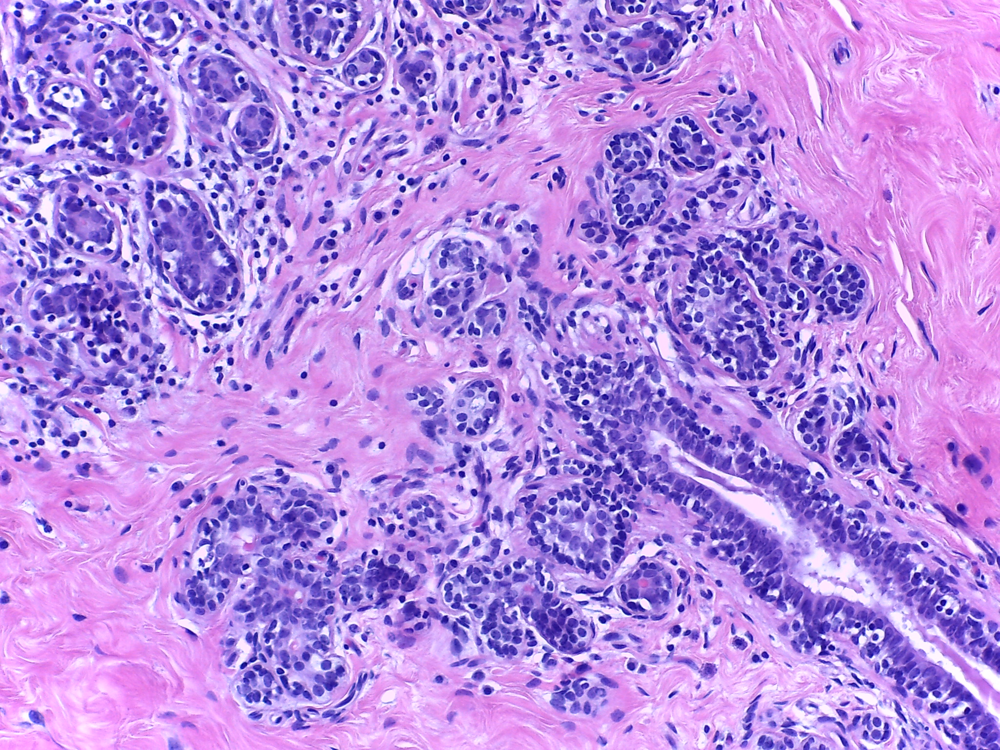

In [15]:
# PIL Image.fromarray can display the images, since they are stored as lists of numpy arrays:
Image.fromarray(training_collection[0][0])

In [5]:
## iterate through the image collections
## standardize brightness
## normalize using vahadane
## cut image into patches and save in its own folder

# initiate VahadaneNormalizer. call fit and transform with it on images
vahadane = VahadaneNormalizer()

# image collection is a dict of numpy arrays
for folder,grade in test_collection.items():
    
    # pull out the pertinent folder name from the key
    patch_dir_name = os.path.basename(folder.strip('/*.tif')) + '_patches'
    patch_dir = f"datasets/{patch_dir_name}"

    # make a directory for patches of each grading
    try:
        os.mkdir(patch_dir)
    except:
        pass
    
    # process the numpy array and save as image patch
    count = 0
    for image in grade:
        
        # use StainTools to standardize the brightness
        x = standardize_brightness(image)
        # normalize image
        vahadane.fit(x)
        x = vahadane.transform(x)
        # extract random, overlapping 512x512 patches 
        patch_array = extract_patches_2d(x,
                                    patch_size=(512,512), 
                                    max_patches=35,
                                    random_state=19)
        patches = []
        for i,patch in enumerate(patch_array):
            p = Image.fromarray(patch)
            patches.append(p)
            
        patch_count = 0
        for x in patches:
            # save patch in grade directory
            x.save(f"{patch_dir}/{count}_p{patch_count}.png")
            patch_count += 1
        
        count += 1


Using brightness standardization


---
#### DataGenerators : training and validation
---

In [5]:
from keras.preprocessing.image import ImageDataGenerator, save_img, load_img, image, img_to_array, array_to_img, DirectoryIterator

1. use the ImageDataGnerator class to set up the rotations and vertical flips
2. use .flow_from_directory to pull in and augment images on the fly

In [32]:
# augment the dataset
data_gen = ImageDataGenerator(horizontal_flip = True,
                              rotation_range = 90,
                              validation_split = .20, 
                              vertical_flip = True,
                              fill_mode = 'constant'
                             )


# creating a generator for the training data reduces the memory burder
traingen = data_gen.flow_from_directory(batch_size=1, 
                                        directory="/Users/saqibnizami/notebooks/DSI-US-4/Capstone/datasets/training_patches/", 
                                        target_size=(512,512),
                                        subset="training",
                                        save_to_dir='/Users/saqibnizami/notebooks/DSI-US-4/Capstone/datasets/aug_training',
                                        save_prefix='training',
                                        save_format='png',
                                        seed=19
                                        )

# validation set generator using the subset defined in ImageDataGenerator
# uses the last 20% of the training data as a validation set
valgen = data_gen.flow_from_directory(batch_size=1, 
                                        directory="/Users/saqibnizami/notebooks/DSI-US-4/Capstone/datasets/training_patches/", 
                                        target_size=(512,512),
                                        subset="validation",
                                        save_to_dir='/Users/saqibnizami/notebooks/DSI-US-4/Capstone/datasets/aug_training',
                                        save_prefix='validation',
                                        save_format='png',
                                        seed=19
                                        )

In [57]:
dataflow.class_indices

{'benign': 0, 'in_situ': 1, 'invasive': 2, 'normal': 3}

In [58]:
dataflow.samples

6972

In [66]:
dataflow.image_data_generator()

'/Users/saqibnizami/notebooks/DSI-US-4/Capstone/datasets/training_patches/'